In [37]:
!pip install kaggle

In [38]:
from google.colab import drive
drive.mount('mount')

Drive already mounted at mount; to attempt to forcibly remount, call drive.mount("mount", force_remount=True).


In [39]:
!cp mount/MyDrive/kaggle.json .

In [40]:
!KAGGLE_CONFIG_DIR=$(pwd) kaggle datasets download syedanwarafridi/vehicle-sales-data

Dataset URL: https://www.kaggle.com/datasets/syedanwarafridi/vehicle-sales-data
License(s): MIT
vehicle-sales-data.zip: Skipping, found more recently modified local copy (use --force to force download)


In [41]:
!unzip -o vehicle-sales-data.zip

Archive:  vehicle-sales-data.zip
  inflating: car_prices.csv          


In [42]:
from string import Template
import IPython.display as display

In [43]:
import numpy as np
import pandas as pd
df = pd.read_csv('car_prices.csv')#, encoding = "ISO-8859-1")

<h1>Exploratory Data Analysis of Car Sales</h1>

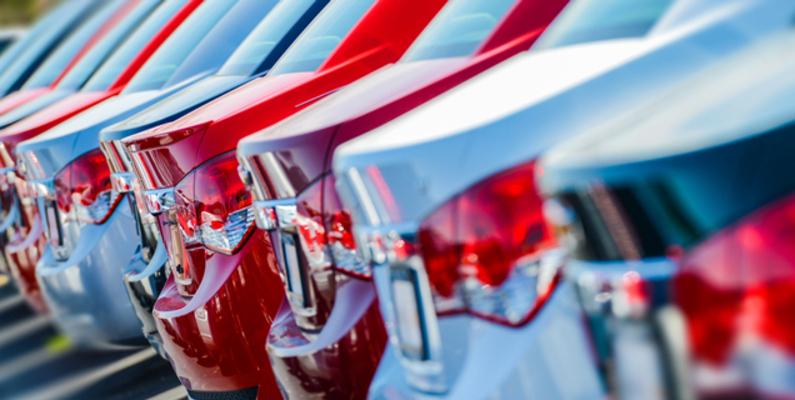

Using the dataset from https://www.kaggle.com/datasets/syedanwarafridi/vehicle-sales-data we can analyze car sales across the United States.



In [44]:
df.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


<h2>Data Cleaning</h2>

<h4>Fix saledate column dtype</h4>

In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 558837 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          558837 non-null  int64  
 1   make          548536 non-null  object 
 2   model         548438 non-null  object 
 3   trim          548186 non-null  object 
 4   body          545642 non-null  object 
 5   transmission  493485 non-null  object 
 6   vin           558833 non-null  object 
 7   state         558837 non-null  object 
 8   condition     547017 non-null  float64
 9   odometer      558743 non-null  float64
 10  color         558088 non-null  object 
 11  interior      558088 non-null  object 
 12  seller        558837 non-null  object 
 13  mmr           558799 non-null  float64
 14  sellingprice  558825 non-null  float64
 15  saledate      558825 non-null  object 
dtypes: float64(4), int64(1), object(11)
memory usage: 68.2+ MB


In [46]:
def month_to_num(month):
    month_dict = {
        'Jan': '01', 'Feb': '02', 'Mar': '03', 'Apr': '04',
        'May': '05', 'Jun': '06', 'Jul': '07', 'Aug': '08',
        'Sep': '09', 'Oct': '10', 'Nov': '11', 'Dec': '12'
    }
    return month_dict.get(month)

df['saledate'] = pd.to_datetime(df['saledate'].str.split(" ").apply(lambda l: "{year}-{month}-{day}".format(year=l[3], month=month_to_num(l[1]), day=l[2]) if isinstance(l, list) and len(l) >= 4 else np.nan))
df.dropna(subset=['saledate'], axis=0, inplace=True)
df.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-15
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-29
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18


In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 558799 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   year          558799 non-null  int64         
 1   make          548498 non-null  object        
 2   model         548400 non-null  object        
 3   trim          548148 non-null  object        
 4   body          545604 non-null  object        
 5   transmission  493448 non-null  object        
 6   vin           558799 non-null  object        
 7   state         558799 non-null  object        
 8   condition     547005 non-null  float64       
 9   odometer      558705 non-null  float64       
 10  color         558050 non-null  object        
 11  interior      558050 non-null  object        
 12  seller        558799 non-null  object        
 13  mmr           558799 non-null  float64       
 14  sellingprice  558799 non-null  float64       
 15  saledate      558799 n

<h3>Handling missing values</h3>

In [48]:
df.isnull().sum()

,0
year,0
make,10301
model,10399
trim,10651
body,13195
transmission,65351
vin,0
state,0
condition,11794
odometer,94


<h4>Fix transmission column</h4>

In [49]:
df.groupby('transmission').size()

,0
transmission,
automatic,475904
manual,17544


In [50]:
df['transmission'].fillna('automatic', inplace=True)
df.groupby('transmission').size()

,0
transmission,
automatic,541255
manual,17544


In [51]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 558799 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   year          558799 non-null  int64         
 1   make          548498 non-null  object        
 2   model         548400 non-null  object        
 3   trim          548148 non-null  object        
 4   body          545604 non-null  object        
 5   transmission  558799 non-null  object        
 6   vin           558799 non-null  object        
 7   state         558799 non-null  object        
 8   condition     547005 non-null  float64       
 9   odometer      558705 non-null  float64       
 10  color         558050 non-null  object        
 11  interior      558050 non-null  object        
 12  seller        558799 non-null  object        
 13  mmr           558799 non-null  float64       
 14  sellingprice  558799 non-null  float64       
 15  saledate      558799 n

<h4>Drop rows missing values for make and model columns</h4>

In [52]:
df.dropna(subset=['make', 'model'], inplace=True)

In [53]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 548400 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   year          548400 non-null  int64         
 1   make          548400 non-null  object        
 2   model         548400 non-null  object        
 3   trim          548050 non-null  object        
 4   body          545506 non-null  object        
 5   transmission  548400 non-null  object        
 6   vin           548400 non-null  object        
 7   state         548400 non-null  object        
 8   condition     536693 non-null  float64       
 9   odometer      548310 non-null  float64       
 10  color         547671 non-null  object        
 11  interior      547671 non-null  object        
 12  seller        548400 non-null  object        
 13  mmr           548400 non-null  float64       
 14  sellingprice  548400 non-null  float64       
 15  saledate      548400 n

<h4>Fix color and interior columns</h4>

In [54]:
df['color'].unique()

array(['white', 'gray', 'black', 'red', 'silver', 'blue', 'brown',
       'beige', 'purple', 'burgundy', '—', 'gold', 'yellow', 'green',
       'charcoal', nan, 'orange', 'off-white', 'turquoise', 'pink',
       'lime'], dtype=object)

In [55]:
df['interior'].unique()

array(['black', 'beige', 'tan', '—', 'gray', 'brown', 'burgundy', 'white',
       nan, 'silver', 'off-white', 'blue', 'red', 'yellow', 'green',
       'purple', 'orange', 'gold'], dtype=object)

In [56]:
df['color'].replace('—', np.nan, inplace=True)
df['interior'].replace('—', np.nan, inplace=True)

df.dropna(subset=['color', 'interior'], inplace=True)

In [57]:
df['color'].unique()

array(['white', 'gray', 'black', 'red', 'silver', 'blue', 'brown',
       'beige', 'purple', 'burgundy', 'gold', 'yellow', 'green',
       'charcoal', 'orange', 'off-white', 'turquoise', 'pink', 'lime'],
      dtype=object)

In [58]:
df['interior'].unique()

array(['black', 'beige', 'tan', 'gray', 'brown', 'burgundy', 'white',
       'silver', 'off-white', 'blue', 'red', 'yellow', 'green', 'purple',
       'orange', 'gold'], dtype=object)

<h4>Fix body column</h4>

In [59]:
df['body'].unique()

array(['SUV', 'Sedan', 'Convertible', 'Coupe', 'Wagon', 'Hatchback',
       'Crew Cab', 'G Coupe', 'G Sedan', 'Elantra Coupe', 'Genesis Coupe',
       'Minivan', nan, 'Van', 'Double Cab', 'King Cab', 'SuperCrew',
       'CTS Coupe', 'Extended Cab', 'E-Series Van', 'SuperCab',
       'Regular Cab', 'G Convertible', 'Koup', 'Quad Cab', 'CrewMax Cab',
       'CTS-V Coupe', 'sedan', 'G37 Convertible', 'Access Cab',
       'Club Cab', 'Xtracab', 'Q60 Convertible', 'CTS Wagon', 'G37 Coupe',
       'Mega Cab', 'Cab Plus 4', 'Q60 Coupe', 'Cab Plus',
       'TSX Sport Wagon', 'Promaster Cargo Van', 'Beetle Convertible',
       'GranTurismo Convertible', 'CTS-V Wagon', 'convertible', 'minivan',
       'suv', 'van', 'regular-cab', 'Transit Van', 'g sedan', 'g coupe',
       'hatchback', 'king cab', 'supercrew', 'g convertible', 'crew cab',
       'wagon', 'coupe', 'double cab', 'e-series van', 'regular cab',
       'quad cab', 'g37 convertible', 'supercab', 'extended cab',
       'crewmax cab', '

In [60]:
df['body'] = df['body'].str.lower()
df.dropna(subset=['body'], inplace=True)
df['body'].unique()

array(['suv', 'sedan', 'convertible', 'coupe', 'wagon', 'hatchback',
       'crew cab', 'g coupe', 'g sedan', 'elantra coupe', 'genesis coupe',
       'minivan', 'van', 'double cab', 'king cab', 'supercrew',
       'cts coupe', 'extended cab', 'e-series van', 'supercab',
       'regular cab', 'g convertible', 'koup', 'quad cab', 'crewmax cab',
       'cts-v coupe', 'g37 convertible', 'access cab', 'club cab',
       'xtracab', 'q60 convertible', 'cts wagon', 'g37 coupe', 'mega cab',
       'cab plus 4', 'q60 coupe', 'cab plus', 'tsx sport wagon',
       'promaster cargo van', 'beetle convertible',
       'granturismo convertible', 'cts-v wagon', 'regular-cab',
       'transit van'], dtype=object)

<h4>Conclude data cleaning</h4>

In [61]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 503941 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   year          503941 non-null  int64         
 1   make          503941 non-null  object        
 2   model         503941 non-null  object        
 3   trim          503941 non-null  object        
 4   body          503941 non-null  object        
 5   transmission  503941 non-null  object        
 6   vin           503941 non-null  object        
 7   state         503941 non-null  object        
 8   condition     497875 non-null  float64       
 9   odometer      503895 non-null  float64       
 10  color         503941 non-null  object        
 11  interior      503941 non-null  object        
 12  seller        503941 non-null  object        
 13  mmr           503941 non-null  float64       
 14  sellingprice  503941 non-null  float64       
 15  saledate      503941 n

<h2>Data Analysis</h2>

<h4>Car Sales by Month</h4>

We have 15 years of car sales data across the United States from 1990 to 2015.

Let's first look at which months are popular for car sales.


In [62]:
car_sales_by_month_df = df['saledate']
car_sales_by_month_df.head()

,saledate
0,2014-12-16
1,2014-12-16
2,2015-01-15
3,2015-01-29
4,2014-12-18


In [76]:
# Bar chart of months of year vs. number of sales in each month

s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }

  .bar {
      fill: steelblue;
  }

  .bar:hover {
      fill: orange;
  }

  .axis-label {
      font-size: 12px;
      font-family: sans-serif;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>
<script src="https://d3js.org/topojson.v1.min.js"></script>

<h3>Car Sales by Month</h3>
<div id="$id"></div>

<script>
       const margin = {top: 20, right: 30, bottom: 50, left: 40},
              width = 960 - margin.left - margin.right,
              height = 500 - margin.top - margin.bottom;

        const svg = d3.select("#$id").append("svg")
            .attr("width", width + margin.left + margin.right)
            .attr("height", height + margin.top + margin.bottom)
          .append("g")
            .attr("transform", `translate(${margin.left},${margin.top})`);

        // Parse the date and extract month names
        const parseDate = d3.timeParse("%Y-%m-%d");
        const months = ["January", "February", "March", "April", "May", "June",
                        "July", "August", "September", "October", "November", "December"];

        // Scales
        const x = d3.scaleBand().domain(months).range([0, width]).padding(0.1);
        const y = d3.scaleLinear().range([height, 0]);

        // Load the car sales data and process it by month
        let data = d3.csvParse(`$df`, d3.autoType);

        // Aggregate the number of sales per month
        const salesByMonth = Array(12).fill(0); // Initialize array for 12 months

        data.forEach(d => {
            if (d.saledate) {
                const month = d.saledate.getMonth();   // Extract month (0 = January, 11 = December)
                salesByMonth[month] += 1;        // Increment the count for that month
            }
        });

        console.log(data);

        // Set the y-domain based on the sales data
        y.domain([0, d3.max(salesByMonth)]);

        // Draw the bars
        svg.selectAll(".bar")
            .data(salesByMonth)
            .enter().append("rect")
            .attr("class", "bar")
            .attr("x", (d, i) => x(months[i]))
            .attr("y", d => y(d))
            .attr("width", x.bandwidth())
            .attr("height", d => height - y(d))
            .append("title")  // Tooltip to show sales number on hover
            .text((d, i) => `${months[i]}: ${d} sales`);

        // Add the x-axis
        svg.append("g")
            .attr("transform", `translate(0,${height})`)
            .call(d3.axisBottom(x))
            .selectAll("text")
            .attr("class", "axis-label")
            .attr("y", 10)
            .attr("x", -5)
            .attr("dy", ".35em")
            .attr("transform", "rotate(-45)")
            .style("text-anchor", "end");

        // Add the y-axis
        svg.append("g")
            .call(d3.axisLeft(y));

        // Add axis labels
        svg.append("text")
            .attr("class", "axis-label")
            .attr("x", width / 2)
            .attr("y", height + margin.bottom - 10)
            .style("text-anchor", "middle")
            .text("Months");

        svg.append("text")
            .attr("class", "axis-label")
            .attr("x", -height / 2)
            .attr("y", -margin.left + 15)
            .attr("transform", "rotate(-90)")
            .style("text-anchor", "middle")
            .text("Number of Sales");
</script>
    """
)

display.HTML(s.safe_substitute({"df": car_sales_by_month_df.to_csv(index=False), "id": "chart-car-sales-by-month"}))

<h4>Most Popular Car Colors</h4>

In [64]:
car_sales_by_color_df = df['color']
car_sales_by_color_df.head()

,color
0,white
1,white
2,gray
3,white
4,gray


In [77]:
s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }

  .bar {
      fill: steelblue;
  }

  .bar:hover {
      fill: orange;
  }

  .axis-label {
      font-size: 12px;
      font-family: sans-serif;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>
<script src="https://d3js.org/topojson.v1.min.js"></script>

<h3>Most Popular Car Colors</h3>
<div id="$id"></div>

<script>
        const margin = {top: 20, right: 30, bottom: 50, left: 40},
              width = 960 - margin.left - margin.right,
              height = 500 - margin.top - margin.bottom;

        const svg = d3.select("#$id").append("svg")
            .attr("width", width + margin.left + margin.right)
            .attr("height", height + margin.top + margin.bottom)
          .append("g")
            .attr("transform", `translate(${margin.left},${margin.top})`);

        // Scales
        const x = d3.scaleBand().range([0, width]).padding(0.1);
        const y = d3.scaleLinear().range([height, 0]);

        // Load the car sales data and process it by month
        let data = d3.csvParse(`$df`, d3.autoType);

        // Aggregate the number of cars sold by color
        const salesByColor = d3.rollups(
            data,
            v => v.length,   // Count the number of sales for each color
            d => d.color      // Assuming the column name is 'color'
        );

        // Sort by sales in descending order
        salesByColor.sort((a, b) => b[1] - a[1]);

        // Set the x and y domains
        x.domain(salesByColor.map(d => d[0]));   // Car colors
        y.domain([0, d3.max(salesByColor, d => d[1])]);  // Number of sales

        // Draw the bars
        svg.selectAll(".bar")
            .data(salesByColor)
            .enter().append("rect")
            .attr("class", "bar")
            .attr("x", d => x(d[0]))
            .attr("y", d => y(d[1]))
            .attr("width", x.bandwidth())
            .attr("height", d => height - y(d[1]))
            .append("title")  // Tooltip to show sales number on hover
            .text(d => `${d[0]}: ${d[1]} cars sold`);

        // Add the x-axis
        svg.append("g")
            .attr("transform", `translate(0,${height})`)
            .call(d3.axisBottom(x))
            .selectAll("text")
            .attr("class", "axis-label")
            .attr("y", 10)
            .attr("x", -5)
            .attr("dy", ".35em")
            .attr("transform", "rotate(-45)")
            .style("text-anchor", "end");

        // Add the y-axis
        svg.append("g")
            .call(d3.axisLeft(y));

        // Add axis labels
        svg.append("text")
            .attr("class", "axis-label")
            .attr("x", width / 2)
            .attr("y", height + margin.bottom - 10)
            .style("text-anchor", "middle")
            .text("Car Colors");

        svg.append("text")
            .attr("class", "axis-label")
            .attr("x", -height / 2)
            .attr("y", -margin.left + 15)
            .attr("transform", "rotate(-90)")
            .style("text-anchor", "middle")
            .text("Number of Cars Sold");
</script>
    """
)

display.HTML(s.safe_substitute({"df": car_sales_by_color_df.to_csv(index=False), "id": "chart-most-popular-car-colors"}))

<h4>Car Sales per Seller</h4>

In [66]:
sellers_with_most_sales = df.groupby(['seller']).size().reset_index(name='counts').sort_values(by='counts', ascending=False).reset_index().head(10).seller

data = df.groupby(['year', 'seller']).size().reset_index(name='sales')
data = data[data['seller'].isin(sellers_with_most_sales)]

data.head()

,year,seller,sales
29,1990,tdaf remarketing,1
418,1994,tdaf remarketing,2
695,1995,tdaf remarketing,4
697,1995,the hertz corporation,1
1042,1996,the hertz corporation,3


In [67]:
s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }

  .line {
    fill: none;
    stroke-width: 2px;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>
<script src="https://d3js.org/topojson.v1.min.js"></script>

<h3>Line chart of sales by seller</h3>
<div id="$id"></div>

<script>
    const margin = {top: 20, right: 80, bottom: 50, left: 50},
          width = 960 - margin.left - margin.right,
          height = 500 - margin.top - margin.bottom;

    const parseYear = d3.timeParse("%Y");

    const svg = d3.select("#$id")
        .append("svg")
            .attr("width", width + margin.left + margin.right)
            .attr("height", height + margin.top + margin.bottom)
        .append("g")
            .attr("transform", "translate(" + margin.left + "," + margin.top + ")");

    // Scales
    const x = d3.scaleTime().range([0, width]);
    const y = d3.scaleLinear().range([height, 0]);
    const color = d3.scaleOrdinal(d3.schemeCategory10);

    // Line generator
    const line = d3.line()
        .x(d => x(d.year))
        .y(d => y(d.sales));

    let salesData = d3.csvParse(`$df`, d3.autoType);
    salesData.forEach(d => {
        d.year = parseYear(d.year);
    });

    const salesData2 = d3.group(salesData.map(d => ({
        seller: d.seller,
        year: d.year,
        sales: d.sales // Counting each sale for aggregation
    })), d => d.seller);

    // Set the x and y domains based on the aggregated data
    x.domain(d3.extent(salesData, d => d.year));
    y.domain([0, d3.max(salesData, d => d.sales)]);

    // Create axes
    svg.append("g")
        .attr("transform", `translate(0,${height})`)
        .call(d3.axisBottom(x).ticks(d3.timeYear));

    svg.append("g")
        .call(d3.axisLeft(y));

    // Format the aggregated data
    const aggregatedData = [];
    salesData2.forEach((values, seller) => {
        aggregatedData.push(values);
    });

    // Draw lines for each seller
    const sellerLines = svg.selectAll(".line")
        .data(aggregatedData)
        .enter().append("g")
        .attr("class", "seller");

    sellerLines.append("path")
        .attr("class", "line")
        .attr("d", d => line(d))
        .style("stroke", d => color(d[0].seller));

    // Add seller names as titles for hover
    sellerLines.append("title")
        .text(d => `Seller: ${d[0].seller}`);
</script>
    """
)

display.HTML(s.safe_substitute({"df": data.to_csv(index=False), "id": "g110"}))

<h4>Car Sales Geographically</h4>

Is the dataset balanced geographically, or are only some states represented?

In [68]:
# Prepare the dataset for the choropleth map by aggregating the total sales per state and year
choropleth_sellingprice_data = df.groupby(['year', 'state']).agg({
    'sellingprice': 'sum'
}).reset_index()

choropleth_counts_data = df.groupby(['year', 'state']).size().reset_index(name='counts')

In [78]:
s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>
<script src="https://d3js.org/topojson.v1.min.js"></script>

<h3>Car Sales Choropleth Map</h3>
<label for="yearSelect">Select Year: </label>
<select id="yearSelect"></select>
<div id="radio-buttons">
    <label><input type="radio" name="map-category" value="total_sales" checked>Total Sales</label>
    <label><input type="radio" name="map-category" value="total_selling_price">Aggregated Selling Prices</label>
</div>
<div id="$id"></div>

<script>
    const color = d3.scaleQuantize()
        .domain([0, 1000000])
        .range(d3.range(11).map(d => d3.interpolateBlues(d / 10)));

    const path = d3.geoPath();
    const width = 975, height = 610;

    const svg = d3.select("#$id")
        .append("svg")
        .attr("width", width)
        .attr("height", height)
        .attr("viewBox", [0, 0, 975, 610])
        .attr("style", "max-width: 100%; height: auto;");

    const sellingprices_data = new Map();
    const salecounts_data = new Map();
    let data;
    let yearData;

    // Load US map data (TopoJSON)
    d3.json("https://cdn.jsdelivr.net/npm/us-atlas@3/counties-albers-10m.json").then(us => {

        const namemap = new Map(us.objects.states.geometries.map(d => [d.properties.name, d.id]))

        // Load the car sales data
        const sellingprices = d3.csvParse(`$choropleth_sellingprice_data`, d3.autoType);
        sellingprices.forEach(d => {
            d.sellingprice = +d.sellingprice;
            sellingprices_data.set(stateCodeToName(d.state) + d.year, d.sellingprice);
        });

        const salecounts = d3.csvParse(`$choropleth_counts_data`, d3.autoType);
        salecounts.forEach(d => {
            d.counts = +d.counts;
            salecounts_data.set(stateCodeToName(d.state) + d.year, d.counts);
        });

        // Populate year dropdown
        const years = [...new Set(salecounts.map(d => d.year))].sort();
        const yearSelect = d3.select("#yearSelect");
        yearSelect.selectAll("option")
            .data(years)
            .enter()
            .append("option")
            .text(d => d);

        // Initial map rendering for the first year
        updateMap(years[0]);

        // Update map when a new year is selected
        yearSelect.on("change", function() {
            updateMap();
        });

        const radioSelect = d3.select("#radio-buttons");
        // Update map when a new radio is selected
        radioSelect.on("change", function() {
            updateMap();
        });

        function updateMap() {
            let year = document.querySelector('#yearSelect').value;
            let radiovalue = document.querySelector('input[name="map-category"]:checked').value;

            let values;
            if (radiovalue == "total_sales") {
                data = salecounts_data;
                yearData = salecounts.filter(d => d.year == year);
                values = yearData.map(d => d.counts);
            } else {
                data = sellingprices_data;
                yearData = sellingprices.filter(d => d.year == year);
                values = yearData.map(d => d.sellingprice);
            }

            color.domain([0, d3.max(values)]);

            svg.append("g")
                .selectAll("path")
                .data(topojson.feature(us, us.objects.states).features)
                .join("path")
                .attr("fill", d => {
                    const salesValue = data.get(d.properties.name + year);
                    return salesValue ? color(salesValue) : "#ccc";
                })
                .attr("d", path)
                .append("title")
                .text(d => `${d.properties.name}\n ${data.get(d.properties.name + year) || "No Data"}`);

            svg.append("path")
                .datum(topojson.mesh(us, us.objects.states, (a, b) => a !== b))
                .attr("fill", "none")
                .attr("stroke", "white")
                .attr("stroke-linejoin", "round")
                .attr("d", path);
        }
    });

    function stateCodeToName(code) {
        const states = {
            "AL": "Alabama",
            "AK": "Alaska",
            "AZ": "Arizona",
            "AR": "Arkansas",
            "CA": "California",
            "CO": "Colorado",
            "CT": "Connecticut",
            "DE": "Delaware",
            "FL": "Florida",
            "GA": "Georgia",
            "HI": "Hawaii",
            "ID": "Idaho",
            "IL": "Illinois",
            "IN": "Indiana",
            "IA": "Iowa",
            "KS": "Kansas",
            "KY": "Kentucky",
            "LA": "Louisiana",
            "ME": "Maine",
            "MD": "Maryland",
            "MA": "Massachusetts",
            "MI": "Michigan",
            "MN": "Minnesota",
            "MS": "Mississippi",
            "MO": "Missouri",
            "MT": "Montana",
            "NE": "Nebraska",
            "NV": "Nevada",
            "NH": "New Hampshire",
            "NJ": "New Jersey",
            "NM": "New Mexico",
            "NY": "New York",
            "NC": "North Carolina",
            "ND": "North Dakota",
            "OH": "Ohio",
            "OK": "Oklahoma",
            "OR": "Oregon",
            "PA": "Pennsylvania",
            "RI": "Rhode Island",
            "SC": "South Carolina",
            "SD": "South Dakota",
            "TN": "Tennessee",
            "TX": "Texas",
            "UT": "Utah",
            "VT": "Vermont",
            "VA": "Virginia",
            "WA": "Washington",
            "WV": "West Virginia",
            "WI": "Wisconsin",
            "WY": "Wyoming"
        };

        return states[code.toUpperCase()] || "Unknown State Code";
    }
</script>
    """
)

display.HTML(s.safe_substitute({"choropleth_sellingprice_data": choropleth_sellingprice_data.to_csv(index=False), "choropleth_counts_data": choropleth_counts_data.to_csv(index=False), "id": "g0"}))

<h4>Car Sales by Manufacturer</h4>

Another way we can slice-and-dice the sales is by manufacturer. We can visualize for each car sold in a year, what the model, trim, and body type was.

Let's find out what each manufacturer is selling.

In [70]:
# Prepare the dataset for the interactive bar chart map by counting in each year the total sales per make, body, model, and trim
df_bar_data = df.groupby(['year', 'make', 'body', 'model', 'trim']).size().reset_index(name='counts')

data = {}
for year in df.year.unique():
    data[str(year)] = {
        "name": "flare",
        "children": [],
    }
    df_year = df_bar_data.loc[df_bar_data['year'] == year]

    for make in df_year.make.unique():
        make_child = {
            "name": make,
            "children": [],
        }
        data[str(year)]["children"].append(make_child)
        df_make = df_year.loc[df_year['make'] == make]

        for body in df_make.body.unique():
            body_child = {
                "name": body,
                "children": [],
            }
            make_child["children"].append(body_child)
            df_body = df_make.loc[df_make['body'] == body]

            for model in df_make.model.unique():
                model_child = {
                    "name": model,
                    "children": [],
                }
                body_child["children"].append(model_child)
                df_model = df_body.loc[df_body['model'] == model]

                for trim in df_model.trim.unique():
                    trim_child = {
                        "name": trim,
                        "value": int(df_model.loc[df_model['trim'] == trim].iloc[0]['counts']),
                    }
                    if trim_child["value"] > 0:
                        model_child["children"].append(trim_child)

In [71]:
s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>

<h3>Car Sales By Manufacturer Interactive Bar Chart</h3>
<div id="$id"></div>

<script>
const marginLeft = 100;
const marginBottom = 0;
const marginRight = 30;
const marginTop = 30;

const barStep = 27;
const barPadding = 3 / barStep;

const duration = 750;

let color = d3.scaleOrdinal([true, false], ["steelblue", "#aaa"])

let height = 894;
let width = 2048;

let x = d3.scaleLinear().range([marginLeft, width - marginRight])

let xAxis = g => g
    .attr("class", "x-axis")
    .attr("transform", `translate(0,${marginTop})`)
    .call(d3.axisTop(x).ticks(width / 80, "s"))
    .call(g => (g.selection ? g.selection() : g).select(".domain").remove());

let yAxis = g => g
    .attr("class", "y-axis")
    .attr("transform", `translate(${marginLeft + 0.5},0)`)
    .call(g => g.append("line")
        .attr("stroke", "currentColor")
        .attr("y1", marginTop)
        .attr("y2", height - marginBottom));

function stack(i) {
  let value = 0;
  return d => {
    const t = `translate(${x(value) - x(0)},${barStep * i})`;
    value += d.value;
    return t;
  };
}

function stagger() {
  let value = 0;
  return (d, i) => {
    const t = `translate(${x(value) - x(0)},${barStep * i})`;
    value += d.value;
    return t;
  };
}

function down(svg, d) {
  if (!d.children || d3.active(svg.node())) return;

  // Rebind the current node to the background.
  svg.select(".background").datum(d);

  // Define two sequenced transitions.
  const transition1 = svg.transition().duration(duration);
  const transition2 = transition1.transition();

  // Mark any currently-displayed bars as exiting.
  const exit = svg.selectAll(".enter")
      .attr("class", "exit");

  // Entering nodes immediately obscure the clicked-on bar, so hide it.
  exit.selectAll("rect")
      .attr("fill-opacity", p => p === d ? 0 : null);

  // Transition exiting bars to fade out.
  exit.transition(transition1)
      .attr("fill-opacity", 0)
      .remove();

  // Enter the new bars for the clicked-on data.
  // Per above, entering bars are immediately visible.
  const enter = bar(svg, down, d, ".y-axis")
      .attr("fill-opacity", 0);

  // Have the text fade-in, even though the bars are visible.
  enter.transition(transition1)
      .attr("fill-opacity", 1);

  // Transition entering bars to their new y-position.
  enter.selectAll("g")
      .attr("transform", stack(d.index))
    .transition(transition1)
      .attr("transform", stagger());

  // Update the x-scale domain.
  x.domain([0, d3.max(d.children, d => d.value)]);

  // Update the x-axis.
  svg.selectAll(".x-axis").transition(transition2)
      .call(xAxis);

  // Transition entering bars to the new x-scale.
  enter.selectAll("g").transition(transition2)
      .attr("transform", (d, i) => `translate(0,${barStep * i})`);

  // Color the bars as parents; they will fade to children if appropriate.
  enter.selectAll("rect")
      .attr("fill", color(true))
      .attr("fill-opacity", 1)
    .transition(transition2)
      .attr("fill", d => color(!!d.children))
      .attr("width", d => x(d.value) - x(0));
}

function up(svg, d) {
  if (!d.parent || !svg.selectAll(".exit").empty()) return;

  // Rebind the current node to the background.
  svg.select(".background").datum(d.parent);

  // Define two sequenced transitions.
  const transition1 = svg.transition().duration(duration);
  const transition2 = transition1.transition();

  // Mark any currently-displayed bars as exiting.
  const exit = svg.selectAll(".enter")
      .attr("class", "exit");

  // Update the x-scale domain.
  x.domain([0, d3.max(d.parent.children, d => d.value)]);

  // Update the x-axis.
  svg.selectAll(".x-axis").transition(transition1)
      .call(xAxis);

  // Transition exiting bars to the new x-scale.
  exit.selectAll("g").transition(transition1)
      .attr("transform", stagger());

  // Transition exiting bars to the parent’s position.
  exit.selectAll("g").transition(transition2)
      .attr("transform", stack(d.index));

  // Transition exiting rects to the new scale and fade to parent color.
  exit.selectAll("rect").transition(transition1)
      .attr("width", d => x(d.value) - x(0))
      .attr("fill", color(true));

  // Transition exiting text to fade out.
  // Remove exiting nodes.
  exit.transition(transition2)
      .attr("fill-opacity", 0)
      .remove();

  // Enter the new bars for the clicked-on data's parent.
  const enter = bar(svg, down, d.parent, ".exit")
      .attr("fill-opacity", 0);

  enter.selectAll("g")
      .attr("transform", (d, i) => `translate(0,${barStep * i})`);

  // Transition entering bars to fade in over the full duration.
  enter.transition(transition2)
      .attr("fill-opacity", 1);

  // Color the bars as appropriate.
  // Exiting nodes will obscure the parent bar, so hide it.
  // Transition entering rects to the new x-scale.
  // When the entering parent rect is done, make it visible!
  enter.selectAll("rect")
      .attr("fill", d => color(!!d.children))
      .attr("fill-opacity", p => p === d ? 0 : null)
    .transition(transition2)
      .attr("width", d => x(d.value) - x(0))
      .on("end", function(p) { d3.select(this).attr("fill-opacity", 1); });
}

// Creates a set of bars for the given data node, at the specified index.
function bar(svg, down, d, selector) {
  const g = svg.insert("g", selector)
      .attr("class", "enter")
      .attr("transform", `translate(0,${marginTop + barStep * barPadding})`)
      .attr("text-anchor", "end")
      .style("font", "10px sans-serif");

  const bar = g.selectAll("g")
    .data(d.children)
    .join("g")
      .attr("cursor", d => !d.children ? null : "pointer")
      .on("click", (event, d) => down(svg, d));

  bar.append("text")
      .attr("x", marginLeft - 6)
      .attr("y", barStep * (1 - barPadding) / 2)
      .attr("dy", ".35em")
      .text(d => d.data.name);

  bar.append("rect")
      .attr("x", x(0))
      .attr("width", d => x(d.value) - x(0))
      .attr("height", barStep * (1 - barPadding));

  return g;
}

const data = $json;

const root = d3.hierarchy(data["2014"])
    .sum(d => d.value)
    .sort((a, b) => b.value - a.value)
    .eachAfter(d => d.index = d.parent ? d.parent.index = d.parent.index + 1 || 0 : 0)

const svg = d3.select("#$id")
    .append("svg")
    .attr("viewBox", [0, 0, width, height])
    .attr("width", width)
    .attr("height", height)
    .attr("style", "max-width: 100%; height: auto;");

x.domain([0, root.value]);

svg.append("rect")
    .attr("class", "background")
    .attr("fill", "none")
    .attr("pointer-events", "all")
    .attr("width", width)
    .attr("height", height)
    .attr("cursor", "pointer")
    .on("click", (event, d) => up(svg, d));

svg.append("g")
    .call(xAxis);

svg.append("g")
    .call(yAxis);

down(svg, root);

let chart = svg.node();



</script>
    """
)

import json
display.HTML(s.safe_substitute({"id": "g1", "json": json.dumps(data)}))

<h4>Car Model Sales Each Year</h4>

In [80]:
# Prepare the dataset for the choropleth map by aggregating the total sales per state and year
sales_histogram_df = df.groupby(['year', 'make']).size().reset_index(name='counts')

print(sales_histogram_df.head(1000))

lowercase_makes =   ["ford", "chevrolet", "dodge", "kia", "toyota", "nissan", "chrysler", "jeep", "hyundai",
           "bmw", "ram", "suburu", "gmc", "volkswagon", "honda", "mercedes-benz", "infinity", "lincoln", "mazda", "mitsubishi", "lexus", "buick", "audi"]

initial_data = {}
for year in sales_histogram_df.year.unique():
    if year not in initial_data:
        initial_data[year] = {}
    for make in lowercase_makes:
       initial_data[year][make] = {
          "name": make,
          "year": int(year),
          "value": 0,
       }

for index, row in sales_histogram_df.iterrows():
    lowercased_make = row.make.lower()
    year = int(row.year)
    if lowercased_make in lowercase_makes:
        initial_data[year][lowercased_make]["value"] = int(row.counts)

data = []
for year, v in initial_data.items():
    for make, v2 in v.items():
        data.append(v2)

print(data)

     year        make  counts
0    1990    Cadillac       1
1    1990   Chevrolet       6
2    1990       Honda       9
3    1990      Jaguar       1
4    1990       Lexus       7
..    ...         ...     ...
854  2015      Subaru     225
855  2015      Toyota     231
856  2015  Volkswagen      58
857  2015       Volvo     391
858  2015       smart       3

[859 rows x 3 columns]
[{'name': 'ford', 'year': 1990, 'value': 0}, {'name': 'chevrolet', 'year': 1990, 'value': 6}, {'name': 'dodge', 'year': 1990, 'value': 0}, {'name': 'kia', 'year': 1990, 'value': 0}, {'name': 'toyota', 'year': 1990, 'value': 7}, {'name': 'nissan', 'year': 1990, 'value': 2}, {'name': 'chrysler', 'year': 1990, 'value': 0}, {'name': 'jeep', 'year': 1990, 'value': 0}, {'name': 'hyundai', 'year': 1990, 'value': 0}, {'name': 'bmw', 'year': 1990, 'value': 0}, {'name': 'ram', 'year': 1990, 'value': 0}, {'name': 'suburu', 'year': 1990, 'value': 0}, {'name': 'gmc', 'year': 1990, 'value': 0}, {'name': 'volkswagon', 'year

In [73]:
s = Template(
    r"""
<style>

  *,
  *::before,
  *::after {
    box-sizing: border-box;
    margin: 0;
    padding: 0;
  }

  #$id {
    text-align: center;
  }

  #$id .axis.x line {
    display: none;
  }

  #$id .axis text {
    font-weight: bold;
    font-family: 'IBM Plex Mono', monospace;
    text-transform: capitalize;
  }
</style>

<script src="https://d3js.org/d3.v7.min.js"></script>

<h3>Car Sales By Year</h3>
<div id="$id"></div>

<script>
  const width = 928;
  const height = 500;
  const marginTop = 20;
  const marginRight = 30;
  const marginBottom = 30;
  const marginLeft = 30;

colors = new Map([
  ["ford", "#2A5784"],
  ["chevrolet", "#43719F"],
  ["dodge", "#5B8DB8"],
  ["kia", "#7AAAD0"],
  ["toyota", "#9BC7E4"],
  ["nissan", "#BADDF1"],
  ["chrysler", "#E1575A"],
  ["jeep", "#EE7423"],
  ["hyundai", "#F59D3D"],
  ["bmw", "#FFC686"],
  ["ram", "#9D7760"],
  ["suburu", "#F1CF63"],
  ["gmc", "#7C4D79"],
  ["volkswagon", "#9B6A97"],
  ["honda", "#BE89AC"],
  ["mercedes-benz", "#D5A5C4"],
  ["infinity", "#EFC9E6"],
  ["lincoln", "#BBB1AC"],
  ["mazda", "#24693D"],
  ["mitsubishi", "#398949"],
  ["lexus", "#61AA57"],
  ["buick", "#7DC470"],
  ["audi", "#B4E0A7"]
])

  const data = $json;

let series = d3.stack()
    .keys(colors.keys())
    //.value((group, key) => group.get(key) ? group.get(key).value : "#CCCCCC")
    .value((group, key) => group.get(key).value)
    .order(d3.stackOrderReverse)
  (d3.rollup(data, ([d]) => d, d => d.year, d => d.name).values())
    .map(s => (s.forEach(d => d.data = d.data.get(s.key)), s))

console.log(data.map(d => d.year));

  // Create scales.
  const x = d3.scaleBand()
      .domain([...new Set(data.map(d => d.year))])
      .rangeRound([marginLeft, width - marginRight]);

  const y = d3.scaleLinear()
      .domain([0, d3.max(series, d => d3.max(d, d => d[1]))]).nice()
      .range([height - marginBottom, marginTop]);

  const color = d3.scaleOrdinal()
      .domain(colors.keys())
      .range(colors.values());

  // Create the SVG container.
  const svg = d3.select("#$id")
      .append("svg")
      .attr("viewBox", [0, 0, width, height])
      .attr("width", width)
      .attr("height", height)
      .attr("style", "max-width: 100%; height: auto;");

  // Create the bars.
  const formatRevenue = x => x

  svg.append("g")
    .selectAll("g")
    .data(series)
    .join("g")
      .attr("fill", ({key}) => color(key))
      .call(g => g.selectAll("rect")
        .data(d => d)
        .join("rect")
          .attr("x", d => x(d.data.year))
          .attr("y", d => y(d[1]))
          .attr("width", x.bandwidth() - 1)
          .attr("height", d => y(d[0]) - y(d[1]))
       .append("title")
          .text(d => `${d.data.name}, ${d.data.year}
${formatRevenue(d.data.value)}`));
  console.log("wt2f");
  console.log(`translate(0,${height - marginBottom})`);
  console.log("wt6f");

  // Create axes.
  svg.append("g")
      .attr("transform", `translate(0,${height - marginBottom})`)
      .call(d3.axisBottom(x)
          .tickValues(d3.ticks(...d3.extent(x.domain()), width / 80))
          .tickSizeOuter(0));

  console.log("wt4f");

  wtf = `translate(${marginLeft},0)`;
  console.log("wtf");
  console.log(wtf);

  svg.append("g")
      .attr("transform", `translate(${marginLeft},0)`)
      .call(d3.axisLeft(y)
          .tickFormat(x => x.toFixed(0)))
      .call(g => g.select(".domain").remove())
      .call(g => g.select(".tick:last-of-type text").clone()
          .attr("x", 3)
          .attr("text-anchor", "start")
          .attr("font-weight", "bold")
          .text("Sales"));

  let chart = Object.assign(svg.node(), {scales: {color}});

</script>
    """
)

import json
display.HTML(s.safe_substitute({"id": "g3", "json": json.dumps(data)}))